# Signals and System Filters Project Phase 3

**Python Implementation of 8 + 1 filters**

In this phase we will apply filters to A voice Signal\
**Note:** we will use our methods at previous phases, 
So if you have problem on that sections please consider resolve their issue first.

- Dr. Farzam
- Spring 1404

## List of Filters to implement
- Moving Average Filter
- FIR Low-Pass Filter
- FIR High-Pass Filter
- FIR Band-Pass Filter
- Differentiator Filter
- Gaussian Filter
- Median Filter
- Box Filter
- Savitzky-Golay Filter (optional)

**Instructions**:
1. Implement the bodies of the following 8 + 1 functions marked with `#TODO`.
2. Implementing each function correctly earns 0.25 score.(last one may include more score)
3. **Do not use AI tools** or copy code from external sources. Any violation will result in 0 score for the project.

## Useful Links

- **Moving Average Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.uniform_filter1d.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.uniform_filter1d.html)
- **FIR Low-Pass Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html)
- **FIR High-Pass Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html)
- **FIR Band-Pass Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html)
- **Differentiator Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.savgol_filter.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.savgol_filter.html)
- **Gaussian Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.gaussian_filter.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.gaussian_filter.html)
- **Median Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.median_filter.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.median_filter.html)
- **Box Filter**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.uniform_filter.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.uniform_filter.html)
- **Savitzky-Golay Filter (optional)**: [https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.savgol_filter.html](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.savgol_filter.html)

Please note that these links are provided for guidance purposes only.
> You are expected to implement the filters independently without directly using the `scipy` library or any library apart from those included at the top of the code.


- **Import necessary Libraries**

In [18]:
import librosa
import numpy as np
import IPython.display as ipd
import matplotlib.pyplot as plt

- load the voice signal (around 37 seconds would take time)

In [8]:
def load_voice_signal(file_path):
    """Load a voice signal from an MP3 file."""
    # Load the audio file with librosa (automatically converts to mono and resamples if needed)
    signal, sample_rate = librosa.load(file_path, sr=None)  # sr=None keeps original sample rate
    
    # Normalize signal to range [-1, 1] (librosa typically does this already, but just in case)
    if signal.max() > 0:
        signal /= np.max(np.abs(signal))
        
    return sample_rate, signal

sample_rate, voice_signal = load_voice_signal("audio.mp3")

print(f"Loaded voice signal: {len(voice_signal)} samples, {sample_rate} Hz sample rate")

# Play the original signal
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

Loaded voice signal: 673920 samples, 48000 Hz sample rate
Original voice signal:


- plot voice comparison

In [9]:
def plot_voice_comparison(original_signal, filtered_signal, sample_rate, title="Voice Signal Comparison"):
    """Plot original and filtered voice signals for comparison."""
    duration = len(original_signal) / sample_rate
    time = np.linspace(0, duration, len(original_signal))
    
    plt.figure(figsize=(14, 8))
    
    # Original signal plot
    plt.subplot(2, 1, 1)
    plt.plot(time, original_signal)
    plt.title('Original Voice Signal')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    # Filtered signal plot
    plt.subplot(2, 1, 2)
    plt.plot(time, filtered_signal)
    plt.title(f'Filtered Voice Signal - {title}')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    plt.tight_layout()
    plt.show()
    
    # Also plot spectrograms for frequency domain comparison
    plt.figure(figsize=(14, 8))
    
    # Original signal spectrogram
    plt.subplot(2, 1, 1)
    plt.specgram(original_signal, Fs=sample_rate, cmap='viridis')
    plt.title('Original Voice Spectrogram')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    
    # Filtered signal spectrogram
    plt.subplot(2, 1, 2)
    plt.specgram(filtered_signal, Fs=sample_rate, cmap='viridis')
    plt.title(f'Filtered Voice Spectrogram - {title}')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    
    plt.tight_layout()
    plt.show()

#### 1. Moving Average Filter
- **Description**: Smooths the signal by averaging values within a sliding window.
- **Steps**:
  1. Iterate through the signal.
  2. For each point, compute the average of the values within the window centered on the point.
  3. Adjust the window boundaries for edge cases.

In [ ]:
def moving_average_filter(signal, window_size):
    filtered_signal = []
    for i in range(len(signal)):
        start = ... #TODO
        end = ... #TODO
        window = signal[start:end]
        filtered_signal.append(sum(window) / len(window))
    return filtered_signal


##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

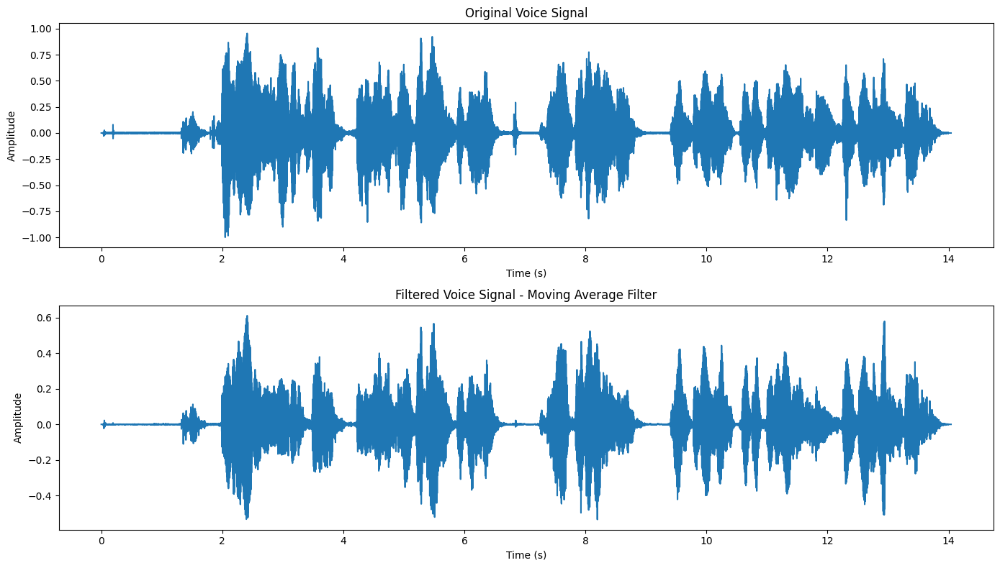

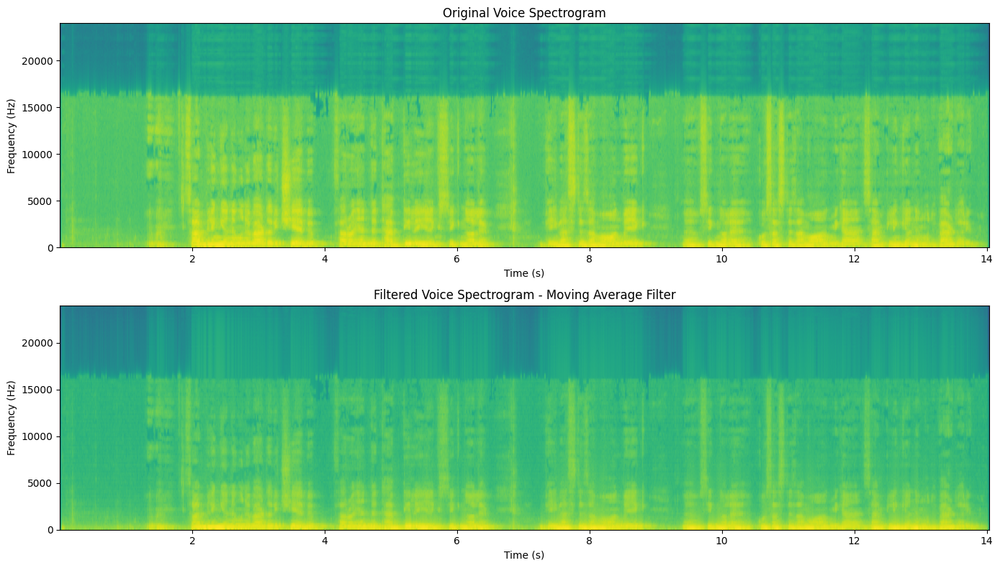

Original voice signal:


Filtered voice signal:


In [20]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply moving average filter
window_size = 100  # You can adjust this value
filtered_signal = moving_average_filter(voice_signal, window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Moving Average Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))


-----------------------------------------------------------------------------------------

#### 2. FIR Low-Pass Filter
- **Description**: Allows low-frequency signals to pass and attenuates high frequencies.
- **Steps**:
  1. Create the filter coefficients using the sinc function for ideal low-pass filter.
  2. Apply a window function (like Hamming) to reduce artifacts.
  3. Normalize the coefficients so their sum is 1.
  4. Convolve the signal with the filter coefficients.

In [ ]:
def fir_low_pass_filter(signal, cutoff_frequency, sample_rate, filter_length):
    nyquist = ... #TODO
    normalized_cutoff = ... #TODO
    filter_coeffs = ... #TODO
    filter_coeffs *= np.hamming(filter_length)
    filter_coeffs /= np.sum(filter_coeffs)
    filtered_signal = np.convolve(signal, filter_coeffs, mode='same')
    return filtered_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

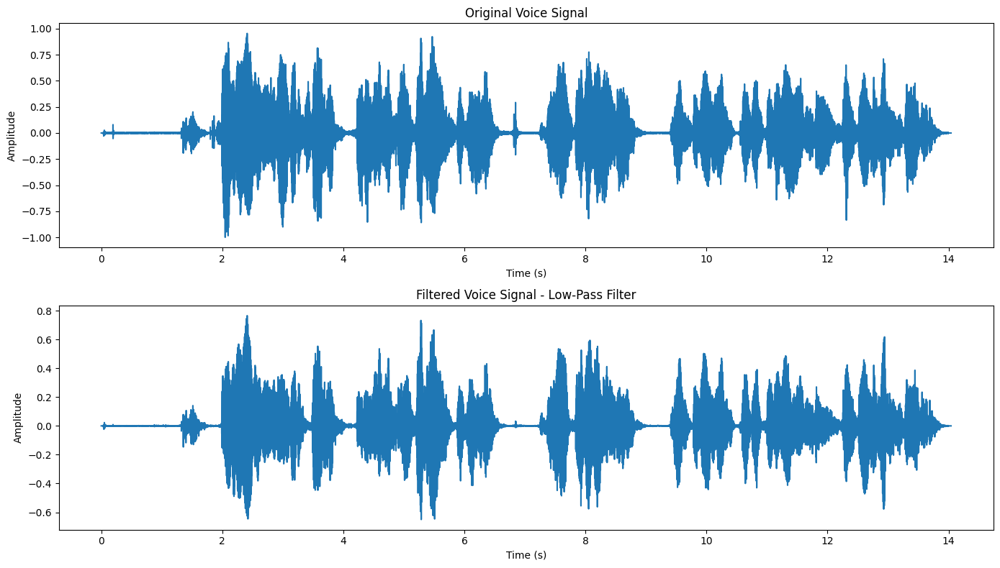

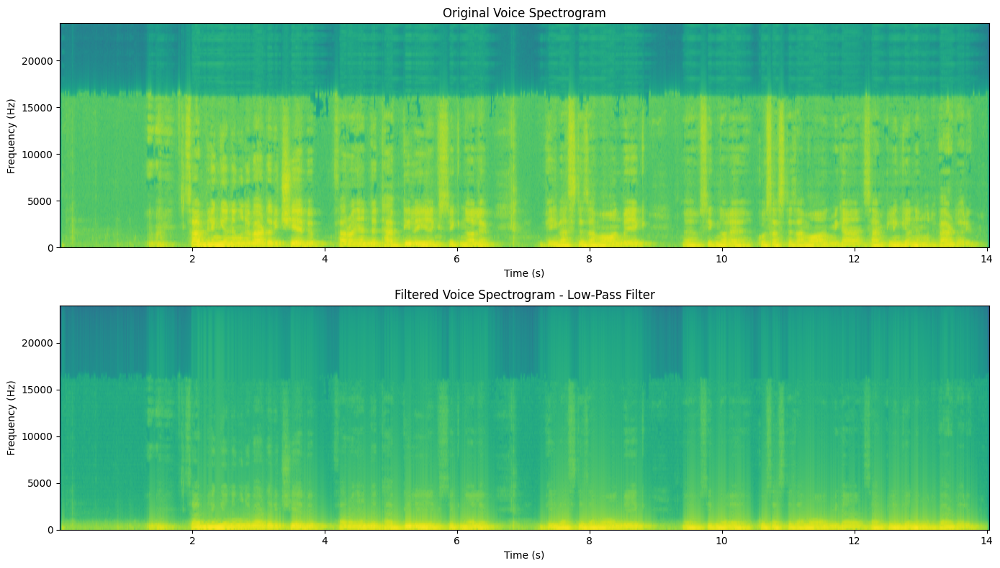

Original voice signal:


Filtered voice signal:


In [23]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply low-pass filter
window_size = 100  # You can adjust this value
filtered_signal = fir_low_pass_filter(voice_signal, window_size, sample_rate, window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Low-Pass Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 3. FIR High-Pass Filter
- **Description**: Allows high-frequency signals to pass and attenuates low frequencies.
- **Steps**:
  1. Use the FIR low-pass filter implementation as a base.
  2. Subtract the low-pass filtered signal from the original signal to get the high-pass filtered signal.

In [ ]:
def fir_high_pass_filter(signal, cutoff_frequency, sample_rate, filter_length):
    low_pass_signal = ... #TODO
    high_pass_signal = ... #TODO
    return high_pass_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

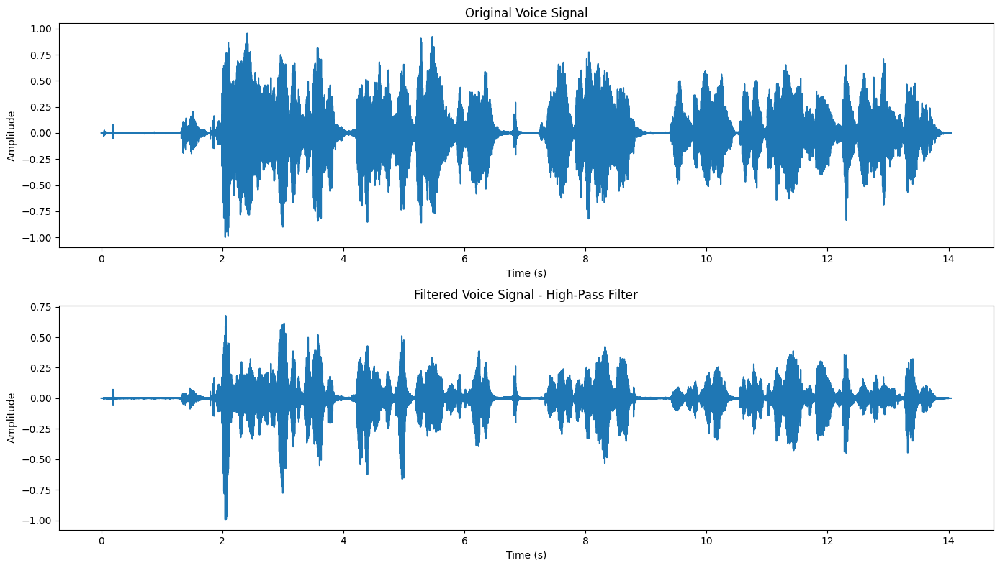

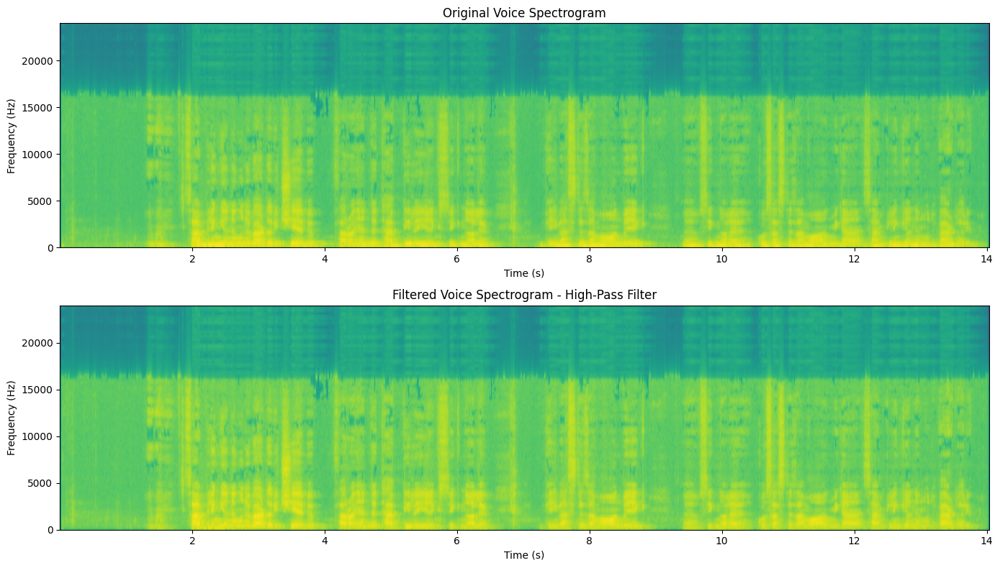

Original voice signal:


Filtered voice signal:


In [25]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply high-pass filter
window_size = 100  # You can adjust this value
filtered_signal = fir_high_pass_filter(voice_signal, window_size, sample_rate, window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "High-Pass Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 4. FIR Band-Pass Filter
- **Description**: Passes frequencies within a specified range and attenuates frequencies outside it.
- **Steps**:
  1. Create a low-pass filter for the upper cutoff frequency.
  2. Create a high-pass filter for the lower cutoff frequency.
  3. Combine the two filters.

In [ ]:
def fir_band_pass_filter(signal, low_cutoff, high_cutoff, sample_rate, filter_length):
    ... #TODO
    return band_pass_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

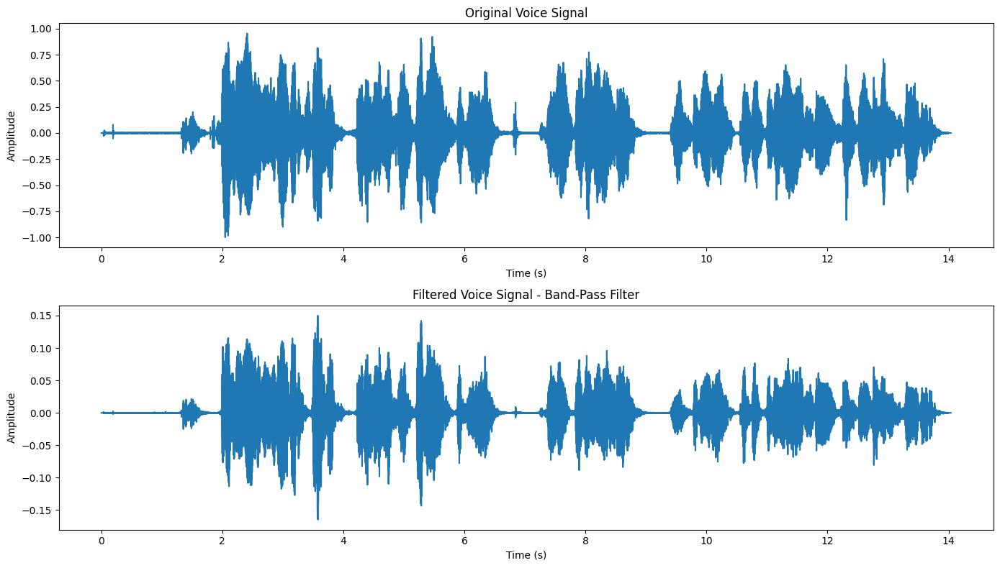

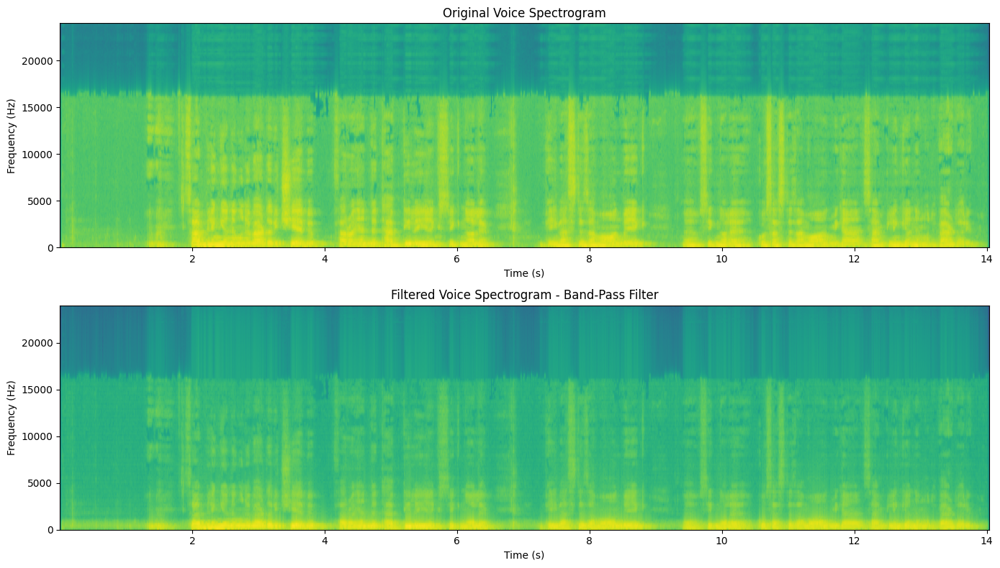

Original voice signal:


Filtered voice signal:


In [28]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply band-pass filter
window_size = 100  # You can adjust this value
filtered_signal = fir_band_pass_filter(voice_signal, low_cutoff= 5, high_cutoff= 15, sample_rate= sample_rate, filter_length= window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Band-Pass Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 5. Differentiator Filter
- **Description**: Computes the difference between consecutive samples.
- **Steps**:
  1. Iterate through the signal.
  2. Compute the difference between adjacent samples.

In [ ]:
def differentiator_filter(signal):
    ... #TODO
    return diff_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

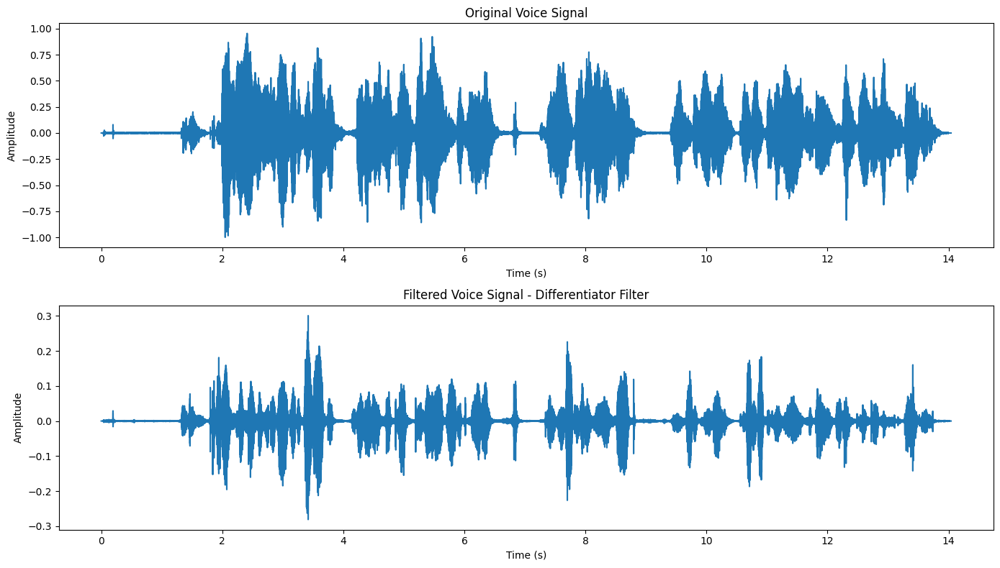

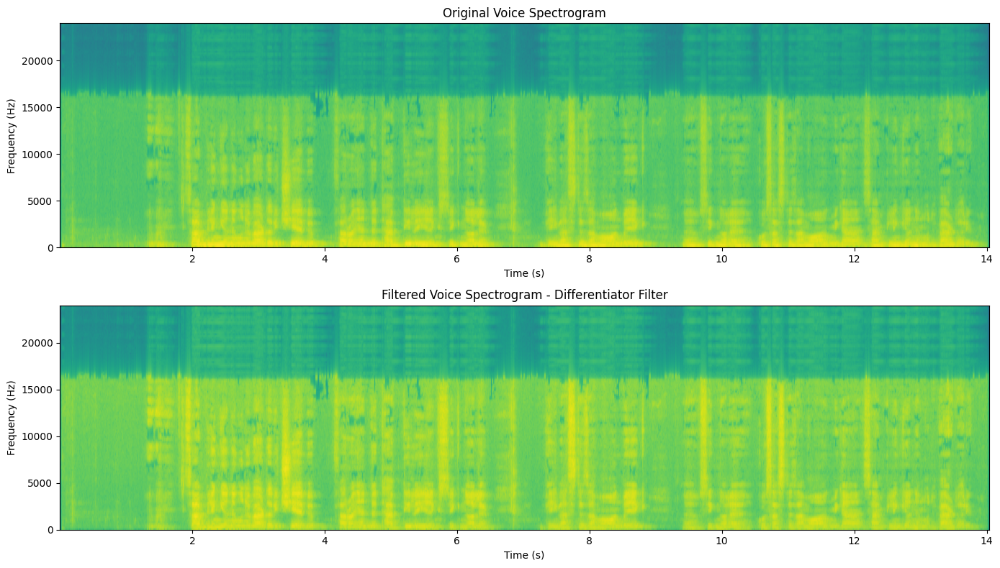

Original voice signal:


Filtered voice signal:


In [32]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply differetiator filter
window_size = 100  # You can adjust this value
filtered_signal = differentiator_filter(voice_signal)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Differentiator Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 6. Gaussian Filter
- **Description**: A smooth low-pass filter with a Gaussian-shaped frequency response.
- **Steps**:
  1. Generate a Gaussian kernel using the formula for a Gaussian function.
  2. Normalize the kernel so its sum is 1.
  3. Convolve the signal with the Gaussian kernel.

In [ ]:
def gaussian_filter(signal, sigma, window_size):
    kernel = ... #TODO
    kernel /= np.sum(kernel)
    filtered_signal = np.convolve(signal, kernel, mode='same')
    return filtered_signal


##### Apply to Voice Signal
In this section, we generate a noisy signal, apply gaussian filter to it, and observe the results.

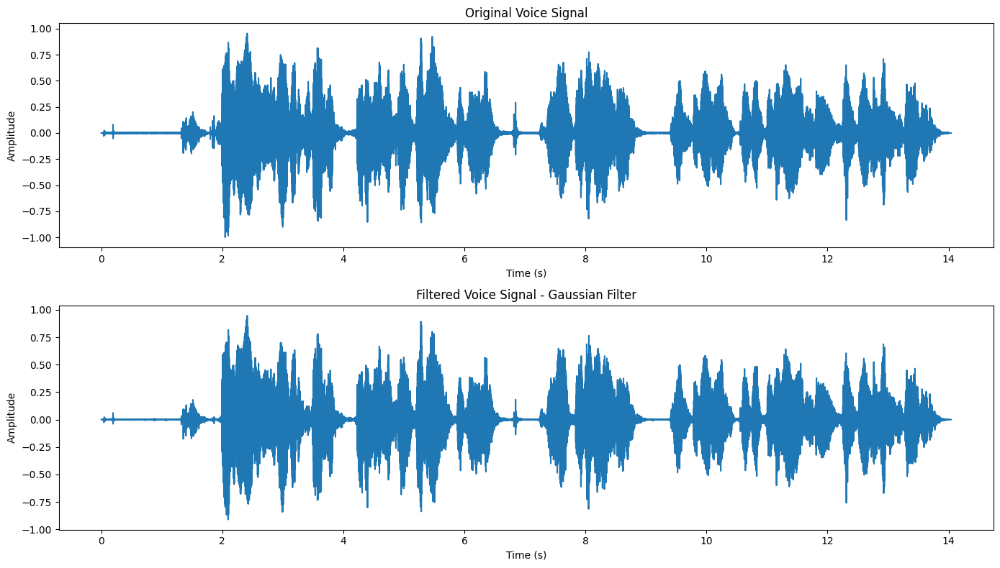

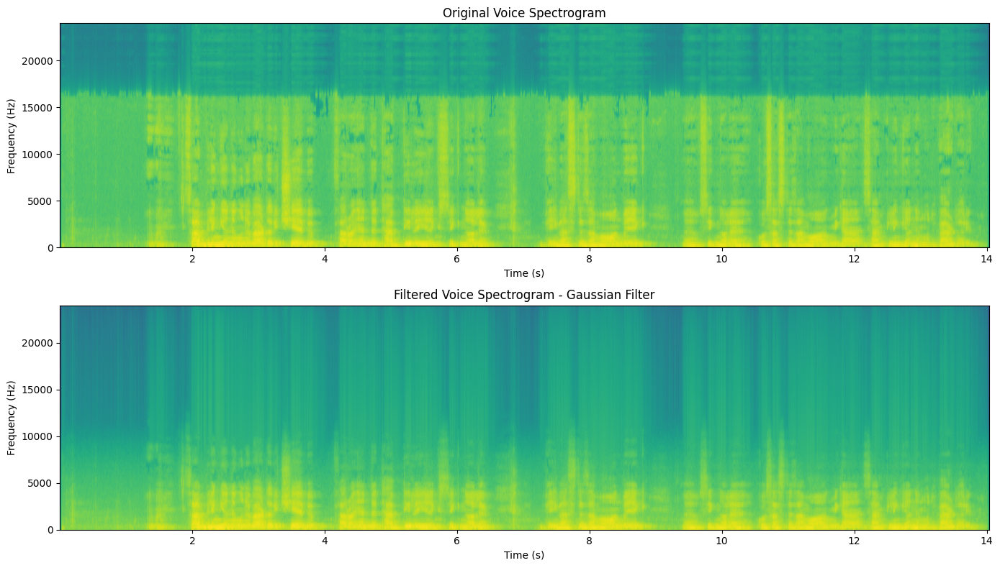

Original voice signal:


Filtered voice signal:


In [34]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply gaussian filter
window_size = 100  # You can adjust this value
filtered_signal = gaussian_filter(voice_signal, sigma= 3, window_size= window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Gaussian Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 7. Median Filter
- **Description**: Replaces each value with the median of a sliding window.
- **Steps**:
  1. Iterate through the signal.
  2. For each point, extract the values in the sliding window.
  3. Compute the median of these values.

In [ ]:
def median_filter(signal, window_size):
    filtered_signal = []
    for i in range(len(signal)):
        start = ... #TODO
        end = ... #TODO
        window = signal[start:end]
        filtered_signal.append(np.median(window))
    return filtered_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

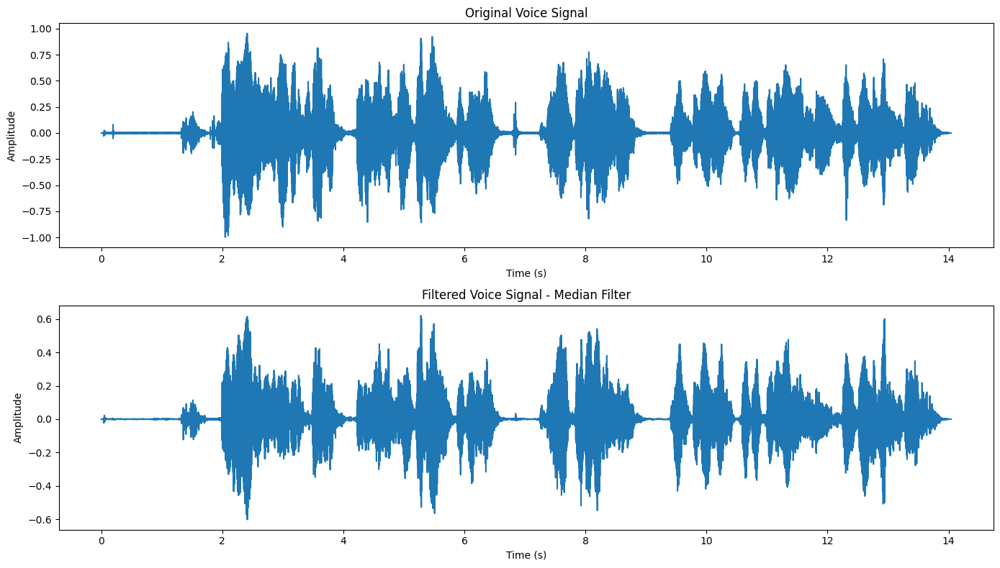

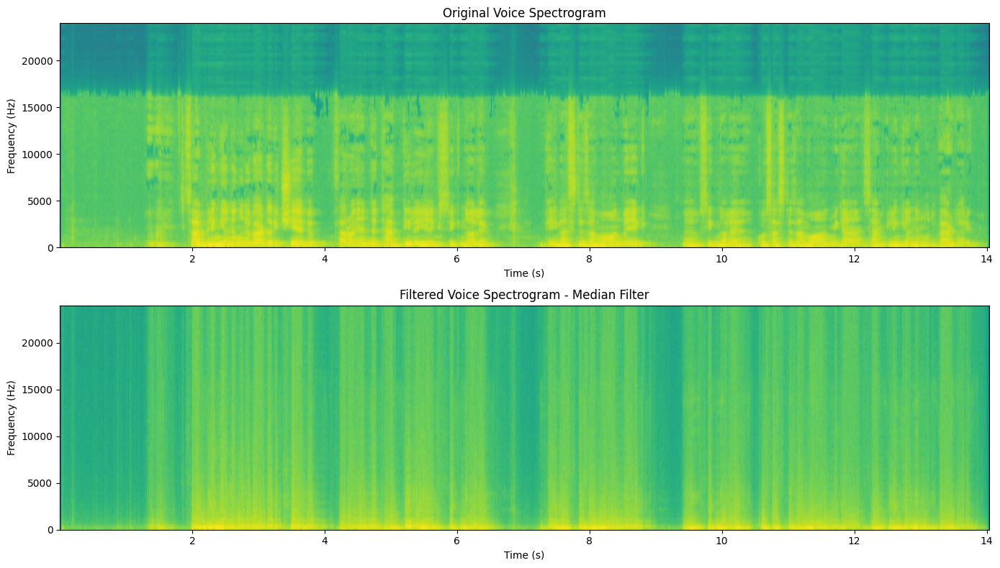

Original voice signal:


Filtered voice signal:


In [36]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply gaussian filter
window_size = 100  # You can adjust this value
filtered_signal = median_filter(voice_signal, window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Median Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 8. Box Filter
- **Description**: Similar to a moving average filter but calculates the average over a strict rectangular window.
- **Steps**:
  1. Take the average of a fixed window of points
  2. ensure the window moves across the signal.

In [ ]:
def box_filter(signal, window_size):
    """
    Applies a box filter to the signal.

    Parameters:
        signal (list or np.ndarray): Input signal to be filtered.
        window_size (int): Size of the rectangular window.

    Returns:
        list: Filtered signal.
    """
    filtered_signal = []
    half_window = window_size // 2

    for i in range(len(signal)):
        # Define the window bounds
        start = ... #TODO
        end = ... #TODO

        # Compute the average in the window
        window = signal[start:end]
        filtered_signal.append(sum(window) / len(window))

    return filtered_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

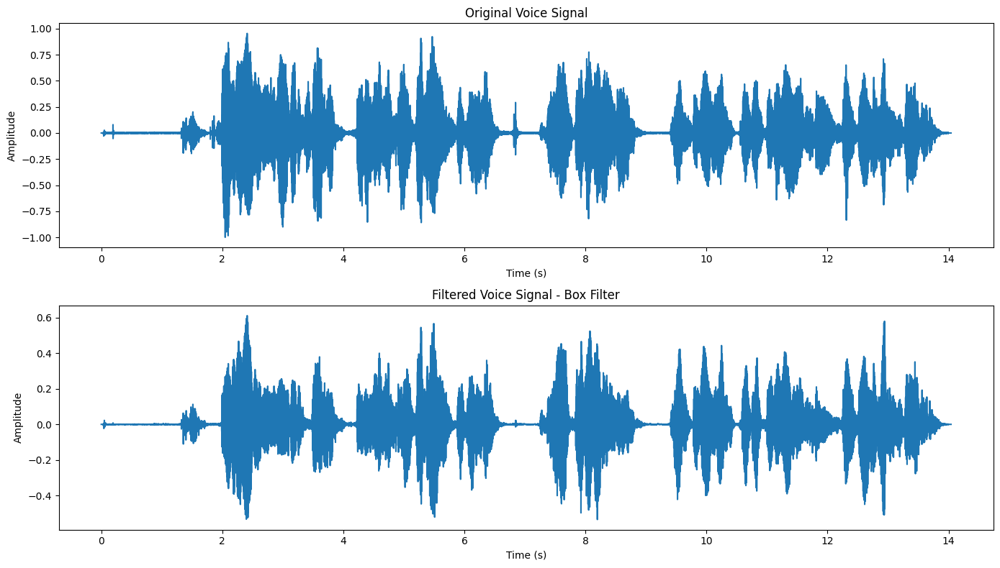

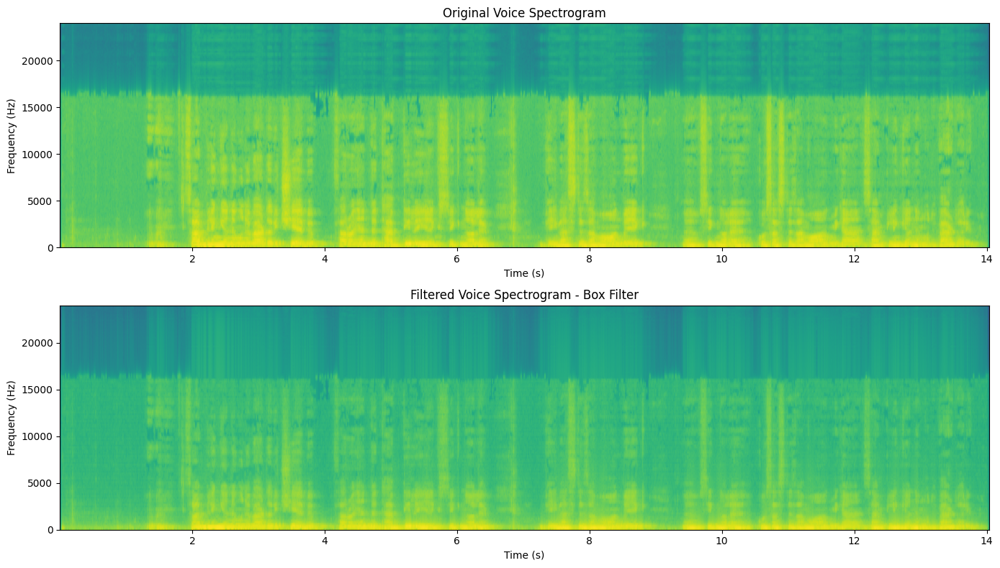

Original voice signal:


Filtered voice signal:


In [39]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply gaussian filter
window_size = 100  # You can adjust this value
filtered_signal = box_filter(voice_signal, window_size)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Box Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))

-----------------------------------------------------------------------------------------

#### 9. Savitzky-Golay Filter
- **Description**: Fits successive subsets of a signal to a polynomial and uses the smoothed polynomial values.
- **Steps**:
  1. Fit a polynomial to the data within a sliding window.
  2. Use the polynomial to estimate the value at the center of the window.

In [ ]:
def savitzky_golay_filter(signal, window_size, poly_order):
    """
    Applies the Savitzky-Golay filter to the signal.

    Parameters:
        signal (list or np.ndarray): Input signal to be filtered.
        window_size (int): Size of the sliding window (must be odd).
        poly_order (int): Order of the polynomial to fit.

    Returns:
        list: Filtered signal.
    """
    if window_size % 2 == 0 or window_size < poly_order + 1:
        raise ValueError("Window size must be odd and greater than poly_order.")

    half_window = window_size // 2
    filtered_signal = []

    # Precompute the polynomial coefficients for the window
    indices = np.arange(-half_window, half_window + 1)
    poly_coeffs = np.linalg.pinv(np.vander(indices, poly_order + 1)).T[half_window]

    for i in range(len(signal)):
        # Extract the window
        start = ... #TODO
        end = ... #TODO
        window = signal[start:end]

        # Pad the window if it is smaller than the full size
        if len(window) < window_size:
            window = np.pad(window, (half_window - (i if i < half_window else 0),
                                     half_window - (len(signal) - 1 - i if i + half_window >= len(signal) else 0)),
                            mode='constant', constant_values=0)

        window = window[:len(poly_coeffs)]
        # Apply the polynomial coefficients to the window
        filtered_signal.append(np.dot(poly_coeffs, window))

    return filtered_signal

##### Apply to Voice Signal
In this section, we use our voice signal, apply moving average filter to it, and observe the results.

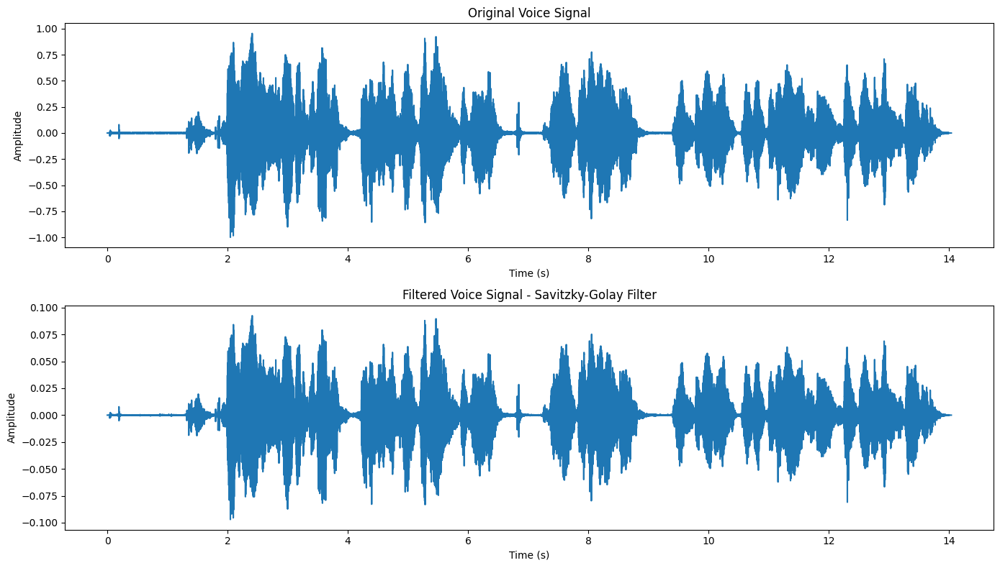

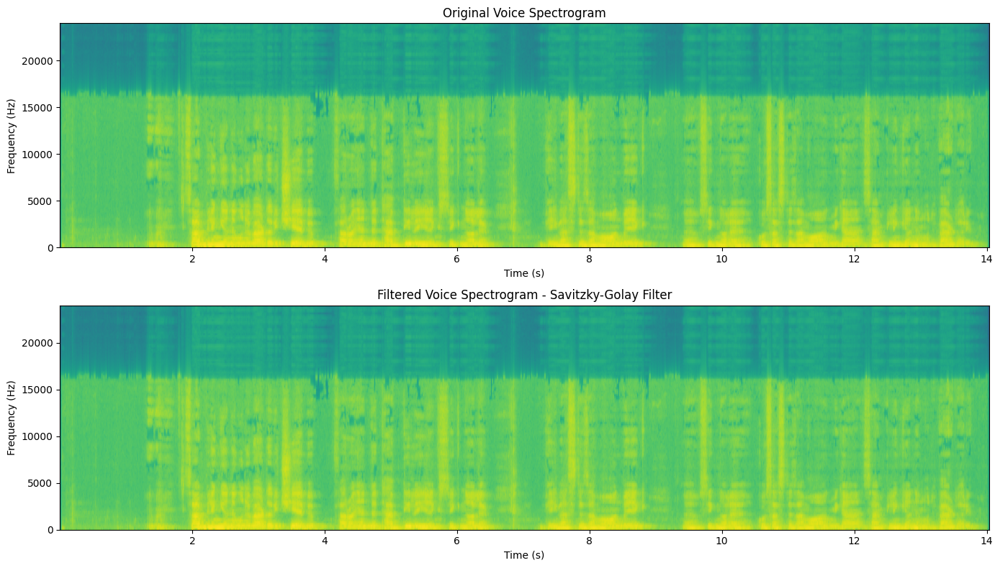

Original voice signal:


Filtered voice signal:


In [47]:
# Create time axis in seconds
duration = len(voice_signal) / sample_rate
t = np.linspace(0, duration, len(voice_signal))

# Apply gaussian filter
window_size = 23  # You can adjust this value
filtered_signal = savitzky_golay_filter(voice_signal, window_size= window_size, poly_order=3)

plot_voice_comparison(voice_signal, filtered_signal, sample_rate, "Savitzky-Golay Filter")

# Play both signals for comparison
print("Original voice signal:")
ipd.display(ipd.Audio(voice_signal, rate=sample_rate))

print("Filtered voice signal:")
ipd.display(ipd.Audio(filtered_signal, rate=sample_rate))